# My awesome LLM-Application

###Setup
First, make the necessary imports.
Note that further imports may have to be made in addition to the ones below, if your application uses additional features such as loaders and tools. You can find the code for these imports in the respective sections of the tutorial notebooks.

In [2]:
!pip install -qU langchain langchain-openai langchain-community langchain-core langchain-huggingface langchain-google-genai

from google.colab import userdata
from langchain_core.prompts import PromptTemplate
from langchain_huggingface import ChatHuggingFace, HuggingFaceEndpoint
from langchain_core.runnables import RunnablePassthrough
from langchain_core.output_parsers import StrOutputParser
from langchain_community.utilities import GoogleSerperAPIWrapper
from langchain_openai import ChatOpenAI
import os
import pprint
import getpass
from IPython.display import Markdown
import IPython.display as ipd
from PIL import Image
import urllib.request

Then, assign the API keys to be able to use OpenAI, Google Serper, Huggingface, etc.

When working with sensitive information like API keys or passwords in Google Colab, it's crucial to handle data securely. As you learnt in the tutorial session, two common approaches for this are using **Colab's Secrets Manager**, which stores and retrieves secrets without exposing them in the notebook, and `getpass`, a Python function that securely prompts users to input secrets during runtime without showing them. Both methods help ensure your sensitive data remains protected.

In [3]:
#You can remove the keys you will not use

#When using Colab Secret Manager
os.environ["OPENAI_API_KEY"] = userdata.get('OPENAI_API_KEY')
#When using getpass
#os.environ['OPENAI_API_KEY'] = getpass.getpass()

#When using Colab Secret Manager
os.environ["SERPER_API_KEY"] = userdata.get('SERPER_API_KEY')
#When using getpass
#os.environ['SERPER_API_KEY'] = getpass.getpass()


## Project Overview — Multimodal Invoice Assistant

### Objective
The goal of this notebook is to build a multimodal AI workflow that extracts structured expense information from invoices and voice messages using large language models.

The notebook follows the same step-by-step approach used in Lab 6. Each stage is explained and executed separately to ensure transparency and reproducibility.

---

### Use case
Expense reporting is often a manual and repetitive process. Users must read invoices, extract key values, and add contextual information explaining the purpose of the expense.

This notebook demonstrates how AI can automate part of this workflow by combining image understanding, speech transcription, and language model reasoning.

---

### Workflow structure

#### Step 0 — Input data

Public URLs for invoices and voice recordings are defined so that the notebook can be executed without manual uploads.

---

#### Step 1 — Invoice processing (image modality)

**Step 1a — Display Invoice 1**  
The first invoice image is loaded from a public URL and displayed.

**Step 1b — Extract values from Invoice 1**  
An LLM extracts structured information such as vendor name, date, amount, and currency.

**Step 1c — Display Invoice 2**  
The second invoice image is loaded and displayed using the same logic.

**Step 1d — Extract values from Invoice 2**  
The same extraction workflow is repeated to demonstrate consistency and reusability.

---

#### Step 2 — Voice processing (audio modality)

**Step 2a — Load and transcribe Voice Recording 1**  
The first voice recording is converted from audio to text.

**Step 2b — Extract structured information from Voice Recording 1**  
An LLM extracts business information. This recording is intentionally complete.

**Step 2c — Load and transcribe Voice Recording 2**  
The second voice recording is processed using the same pipeline.

**Step 2d — Extract and validate Voice Recording 2**  
The second recording intentionally contains missing information.  
The system identifies missing fields and marks the result as incomplete.

---

#### Step 3 — Final aggregation

**Step 3a — Combine all extracted information**  
Invoice and voice outputs are merged into a unified structure.

**Step 3b — Display final table**  
All results are summarized in a structured table including source type and completion status.

---

### Multimodal aspect
This workflow combines:

- Image input (invoice)
- Audio input (voice message)
- Text output (structured data)

---

### Expected result
At the end of the notebook, the reader can follow a clear chained workflow where outputs from one step become inputs for the next step, leading to a final structured summary table.


# Step 0 — Input data

In this step we define the public URLs used in the experiment.

Two invoice images and two voice recordings are hosted publicly so that the notebook can run without manual uploads.

These files will be used in the following steps to demonstrate the full multimodal pipeline.


In [7]:
# Invoice images
invoice_url_1 = "https://raw.githubusercontent.com/automationrisegroup-web/invoice_voice_exam/3730542c430d1ff6bac8735da579e9c695ac7f35/Invoice1.jpg"
invoice_url_2 = "https://raw.githubusercontent.com/automationrisegroup-web/invoice_voice_exam/3730542c430d1ff6bac8735da579e9c695ac7f35/Invoice2.jpg"

# Voice recordings
voice_url_1 = "PASTE_RAW_VOICE1_URL"
voice_url_2 = "PASTE_RAW_VOICE2_URL"


# Step 1 — Invoice processing (image modality)

In this section we process invoice images by displaying them and extracting structured information with an LLM.


## Step 1a — Display Invoice 1

In this step we load the first invoice image from the public URL and display it.

This verifies that the input is accessible and correctly loaded before applying the LLM extraction logic.


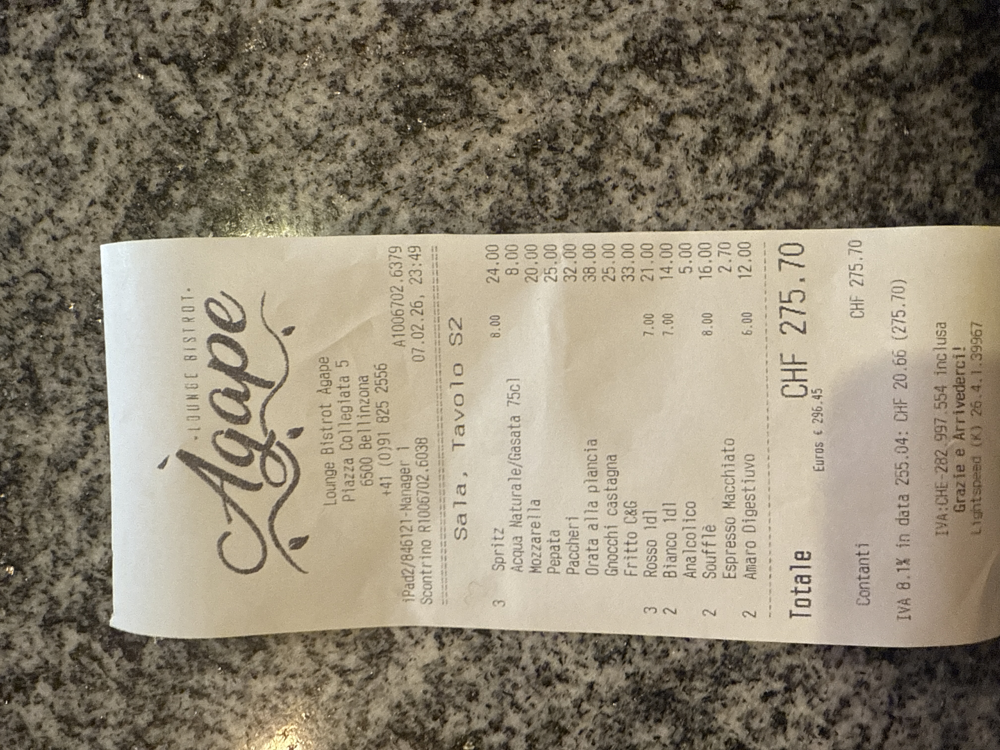

In [9]:
with urllib.request.urlopen(invoice_url_1) as url:
    img=Image.open(url)
    display(img)

## Step 1b — Extract values from Invoice 1

We use the Responses API with GPT-4.1 to extract structured information from the invoice image.



To use the Responses API, we initialize an OpenAI client.
This could also be placed in the initial setup section, but it is shown here explicitly for clarity.

In [17]:
from openai import OpenAI
client = OpenAI()

In [18]:
def extractInvoice(url):
    response = client.responses.create(
        model="gpt-4.1",
        input=[{
            "role": "user",
            "content": [
                {
                    "type": "input_text",
                    "text": "Extract the invoice information from this image."
                            "Return vendor name, date, total amount, currency and location."
                },
                {
                    "type": "input_image",
                    "image_url": url
                }
            ]
        }]
    )

    return response.output_text

Now that the function is defined, we call it to obtain the the 5 required information (Vendor name, date, total amount, currency and location) into a variable invoice1_extraction.

In [19]:
invoice1_extraction = extractInvoice(invoice_url_1)

display(Markdown(invoice1_extraction))


Here is the extracted invoice information from the image:

- **Vendor Name:** Lounge Bistrot Agape
- **Date:** 07.02.26 (February 7, 2026)
- **Total Amount:** 275.70
- **Currency:** CHF (Swiss Francs)
- **Location:** Piazza Collegiata 5, 6500 Bellinzona, Switzerland

## Step 1c — Display Invoice 2

We now repeat the same procedure with a second invoice image.

This demonstrates that the workflow is reusable and can process multiple inputs using the same logic.


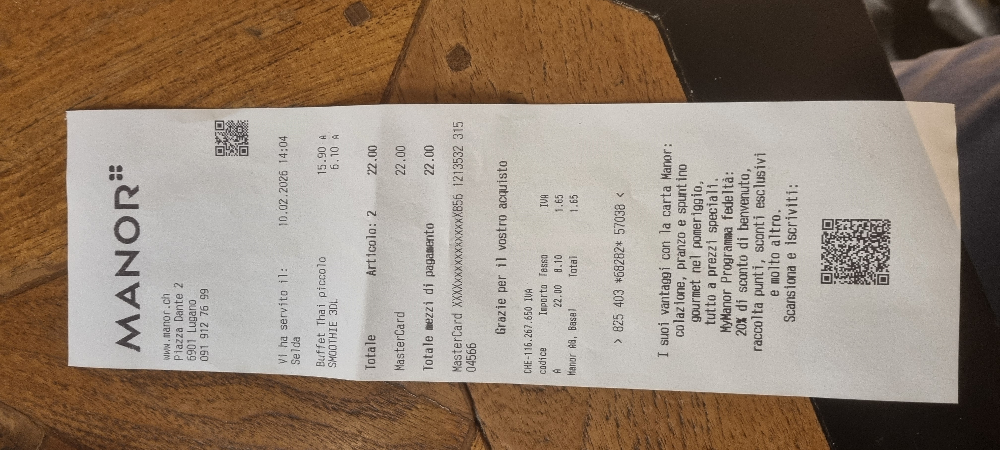

In [20]:
with urllib.request.urlopen(invoice_url_2) as url:
    img=Image.open(url)
    display(img)

## Step 1d — Extract values from Invoice 2

We reuse the same extraction function to process the second invoice.

This confirms that the workflow is consistent and reusable across multiple inputs.


In [21]:
invoice2_extraction = extractInvoice(invoice_url_2)

display(Markdown(invoice2_extraction))


Here is the extracted invoice information from the image:

- **Vendor Name**: MANOR
- **Date**: 10.02.2026 (February 10, 2026)
- **Total Amount**: 22.00
- **Currency**: CHF (Swiss Francs, inferred from location in Switzerland)
- **Location**: Piazza Dante 2, 6901 Lugano, Switzerland

Let me know if you need more details!

xxx

Scalable solution, for in

xxxx

# Step 2 — Voice processing (audio modality)

In this section we process voice recordings by transcribing audio into text and extracting structured information with an LLM.

